## Advanced Lane Finding Project

The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

---
## Compute the camera calibration using chessboard images

In [1]:
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
import pickle
%matplotlib inline

# Check if calibration data exists
try:
    data = pickle.load(open('camera.pickle', 'rb'))
    print("Calibration exists. File loaded.")
except (OSError, IOError) as e:
    # pickle file not present
    # prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
    objp = np.zeros((6*9,3), np.float32)
    objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)

    # Arrays to store object points and image points from all the images.
    objpoints = [] # 3d points in real world space
    imgpoints = [] # 2d points in image plane.

    # Make a list of calibration images
    images = glob.glob('./camera_cal/calibration*.jpg')
    # Step through the list and search for chessboard corners
    for fname in images:
        img = cv2.imread(fname)
        gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
        # Find the chessboard corners
        ret, corners = cv2.findChessboardCorners(gray, (9,6),None)

        # If found, add object points, image points
        if ret == True:
            objpoints.append(objp)
            imgpoints.append(corners)

            # Draw and display the corners
            #img = cv2.drawChessboardCorners(img, (9,6), corners, ret)
            #cv2.imshow('img', img)
            #cv2.waitKey(500)

    #cv2.destroyAllWindows()
    
    # Write pickle file
    data = {"objpoints": objpoints, "imgpoints": imgpoints, "images": images}
    print ("Writing pickle file.")
    with open('camera.pickle', 'wb') as f:
        pickle.dump(data, f)
        print ("Writing done.")

Calibration exists. File loaded.


## Undistort images

In [2]:
# Read in pickled file
#with open('camera.pickle', 'rb') as f:
#    data = pickle.load(f)
#    print("Data loaded.")
    
objpoints = data['objpoints']
imgpoints = data['imgpoints']
images = data['images']

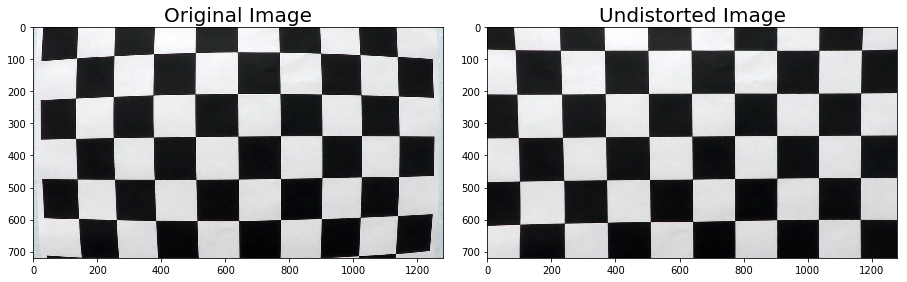

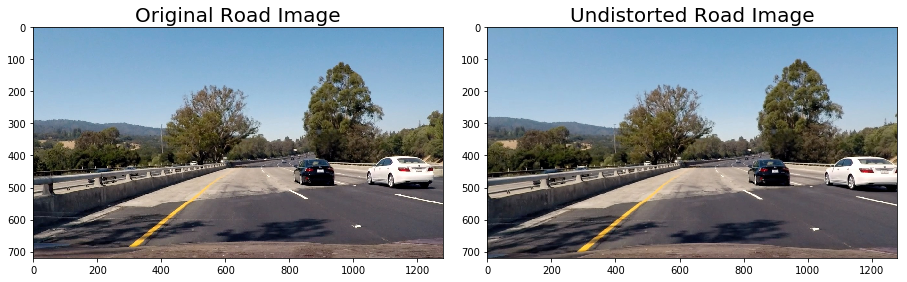

In [5]:
import os
# define output image save path
img_save_path = 'output_images/'
# define a function to undistort an image based on objpoints and imgpoints
def cal_undistort(img, objpoints, imgpoints):
    """Return undistorted image
    
    Keyword arguments:
    img -- image to be undistorted
    objpoints -- 3d points in real world space
    imgpoints -- 2d points in image plane
    """
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    return undist
# get an example image
eg_img = cv2.imread(images[0])
eg_undistorted = cal_undistort(eg_img, objpoints, imgpoints)
# show images and save example
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))
f.tight_layout()
ax1.imshow(eg_img)
ax1.set_title('Original Image', fontsize=20)
ax2.imshow(eg_undistorted)
ax2.set_title('Undistorted Image', fontsize=20)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
f.savefig(os.path.join(img_save_path, 'undistort_image.jpg'))

# now use test images on the road to show an example
road_images = glob.glob('./test_images/test*.jpg')
eg_rd_img = cv2.imread(road_images[3])
eg_rd_undistorted = cal_undistort(eg_rd_img, objpoints, imgpoints)
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))
f.tight_layout()
ax1.imshow(cv2.cvtColor(eg_rd_img, cv2.COLOR_BGR2RGB))
ax1.set_title('Original Road Image', fontsize=20)
ax2.imshow(cv2.cvtColor(eg_rd_undistorted, cv2.COLOR_BGR2RGB))
ax2.set_title('Undistorted Road Image', fontsize=20)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
f.savefig(os.path.join(img_save_path, 'undistort_road_image.jpg'))

## Use color and gradient threshold to create a binary image

#### There two popular methods to detect lanes. The first one is using color selection and the second one is using sobel operator. Start with color selection first.

The idea of using color selection to detect lanes is based upon the fact that lanes consist of white and yellow color. However, it has been proven that the most common color space, i.e., RGB space, is not suitable for picking colors when the image is subject to various lighting conditions. Therefore, I start with showing the images in different color space and observe the lanes in them.

In [6]:
# Show image in HSV space
def show_hsv(img, i):
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV).astype(np.float)
    h_channel = hsv[:,:,0]
    s_channel = hsv[:,:,1]
    v_channel = hsv[:,:,2]
    f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(12, 5))    
    f.tight_layout()
    ax1.imshow(h_channel, cmap='gray')
    ax1.set_title('HSV: H Channel:'+str(i+1), fontsize=20)
    ax2.imshow(s_channel, cmap='gray')
    ax2.set_title('HSV: S Channel:'+str(i+1), fontsize=20)
    ax3.imshow(v_channel, cmap='gray')
    ax3.set_title('HSV: V Channel:'+str(i+1), fontsize=20)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    f.savefig(os.path.join(img_save_path, 'hsv'+str(i+1)+'.jpg'))

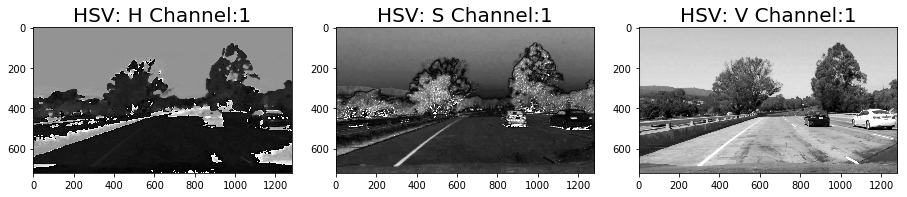

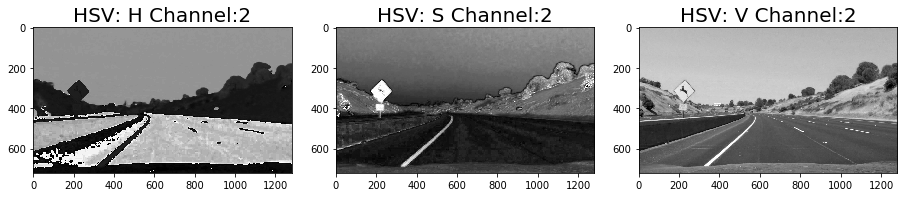

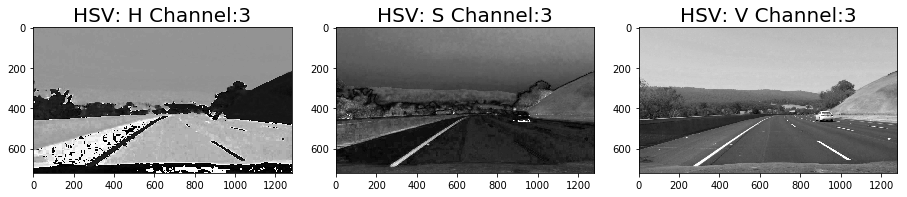

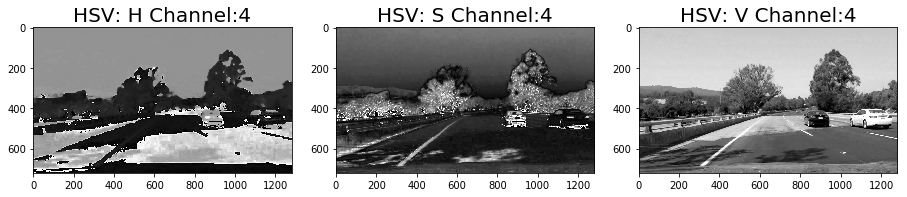

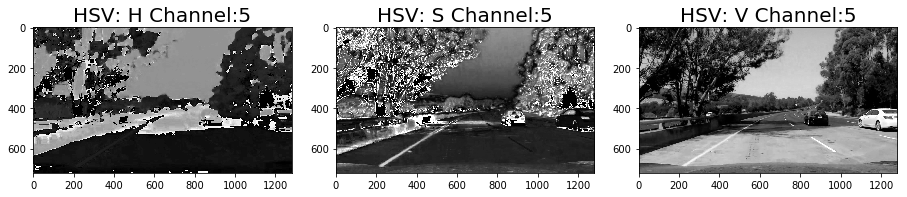

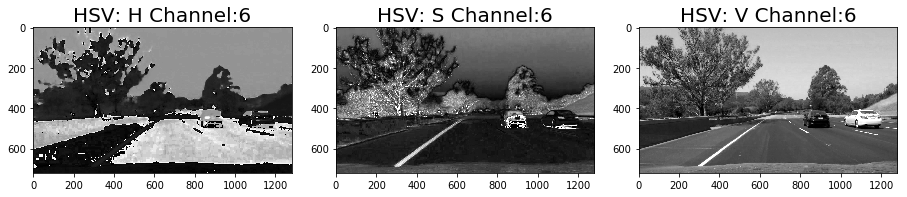

In [7]:
for i, fimg in enumerate(road_images):
    img = cv2.imread(fimg)
    show_hsv(img, i)

Yellow lane appears dark in the H channel and bright in S and V channel. Pay attention to image No.4. Even though part of the yellow lane, close to the bottom of the image, is in the shadow, we can still clearly tell it apart from the road, especially in H and S channel.

In [8]:
# Still worth showing the RGB color space
def show_bgr(img, i):
    b_channel = img[:,:,0]
    g_channel = img[:,:,1]
    r_channel = img[:,:,2]
    f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(12, 5))    
    f.tight_layout()
    ax1.imshow(b_channel, cmap='gray')
    ax1.set_title('BGR: B Channel:'+str(i+1), fontsize=20)
    ax2.imshow(g_channel, cmap='gray')
    ax2.set_title('BGR: G Channel:'+str(i+1), fontsize=20)
    ax3.imshow(r_channel, cmap='gray')
    ax3.set_title('BGR: R Channel:'+str(i+1), fontsize=20)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.) 
    f.savefig(os.path.join(img_save_path, 'bgr'+str(i+1)+'.jpg'))

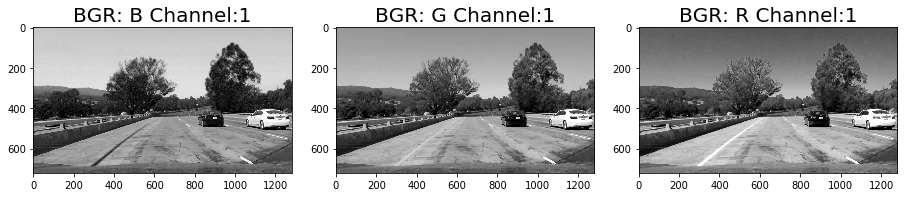

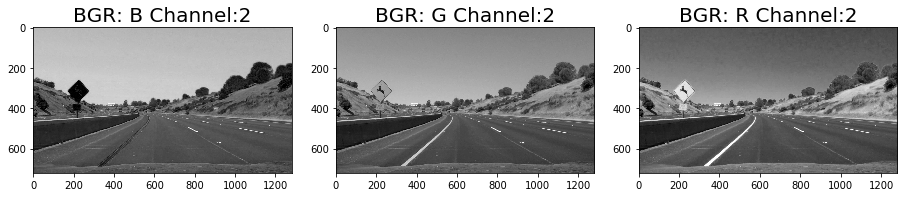

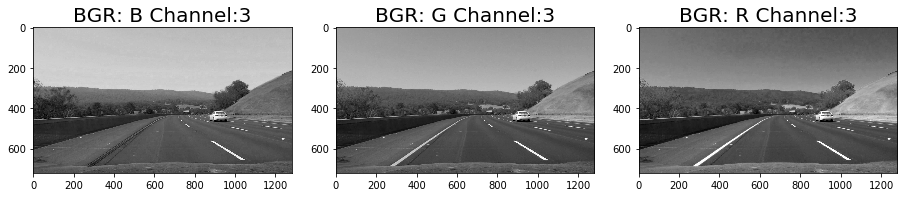

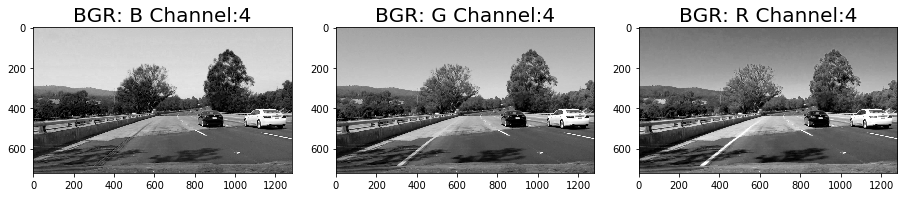

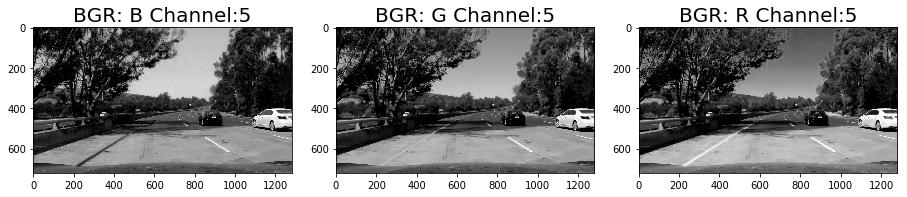

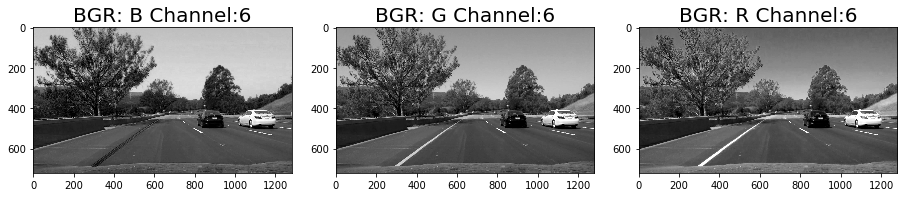

In [9]:
for i, fimg in enumerate(road_images):
    img = cv2.imread(fimg)
    show_bgr(img, i)

In fact, RGB color space is doing well for the white lane. However, again, pay attention to image No.4 and 5. The shadow starts to appear among all the channels, covering the yellow lane marking. This is the reason why I decided not to use RGB color space for color selection, especially for yellow lane.

In [10]:
# Show HLS color space
def show_hls(img, i):
    hls = cv2.cvtColor(img, cv2.COLOR_BGR2HLS).astype(np.float)
    h_channel = hls[:,:,0]
    l_channel = hls[:,:,1]
    s_channel = hls[:,:,2]
    f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(12, 5))    
    f.tight_layout()
    ax1.imshow(h_channel, cmap='gray')
    ax1.set_title('HLS: H Channel:'+str(i+1), fontsize=20)
    ax2.imshow(l_channel, cmap='gray')
    ax2.set_title('HLS: L Channel:'+str(i+1), fontsize=20)
    ax3.imshow(s_channel, cmap='gray')
    ax3.set_title('HLS: S Channel:'+str(i+1), fontsize=20)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)  
    f.savefig(os.path.join(img_save_path, 'hls'+str(i+1)+'.jpg'))

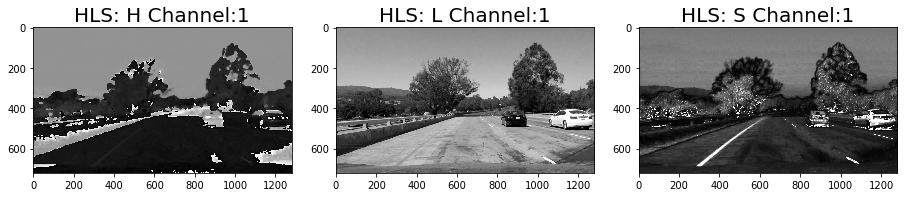

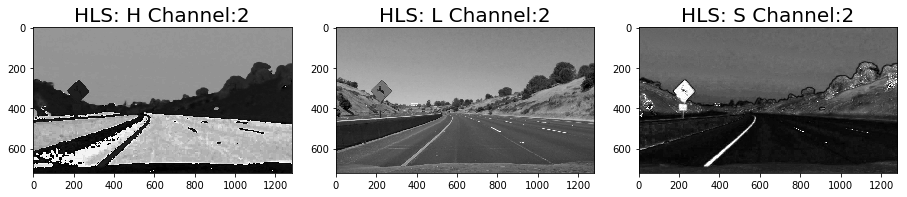

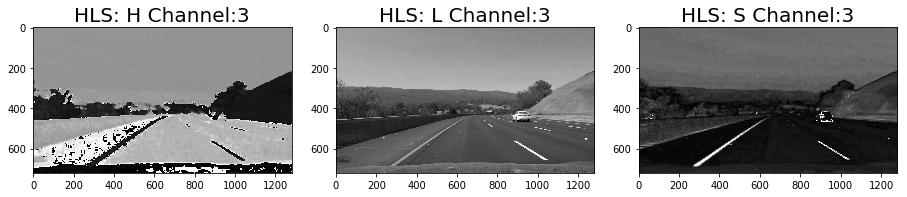

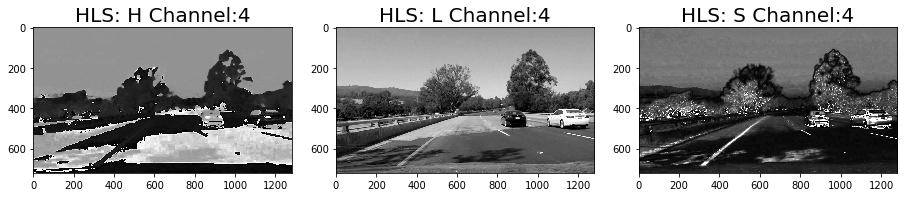

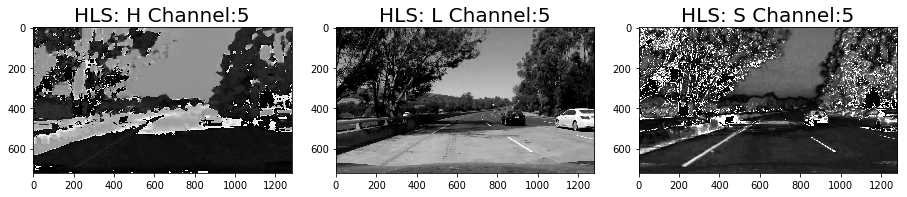

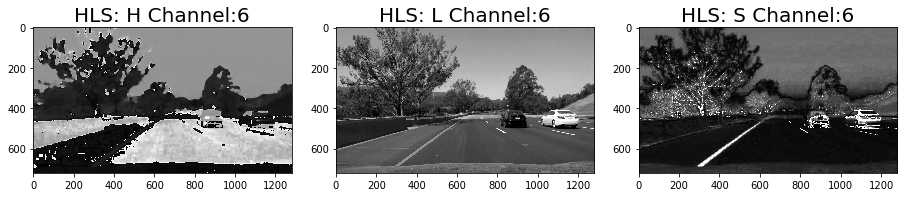

In [11]:
for i, fimg in enumerate(road_images):
    img = cv2.imread(fimg)
    show_hls(img, i)

The HLS space shows similar results as HSV space. However, it seems that just by properly thresholding the S channel we can get most of the job done.

In [12]:
def pick_yellow(img, lower_yellow, upper_yellow, return_binary=False):
    # Convert BGR to HLS
    hls = cv2.cvtColor(img, cv2.COLOR_BGR2HLS)   

    # Threshold the HLS image to get only yellow colors
    mask = cv2.inRange(hls, lower_yellow, upper_yellow)
    # Bitwise-AND mask and original image
    res = cv2.bitwise_and(img, img, mask= mask)
    if return_binary:
        return mask
    else:
        return res

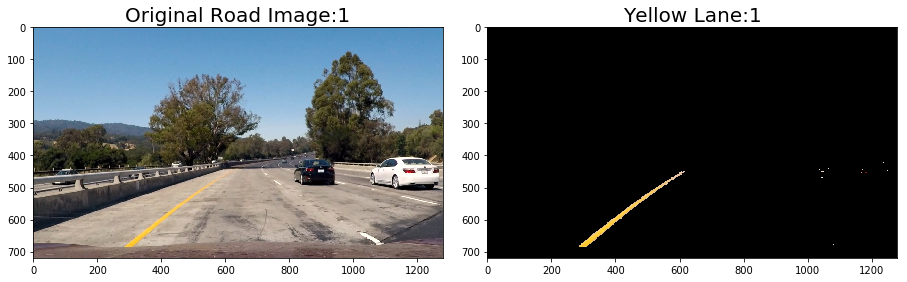

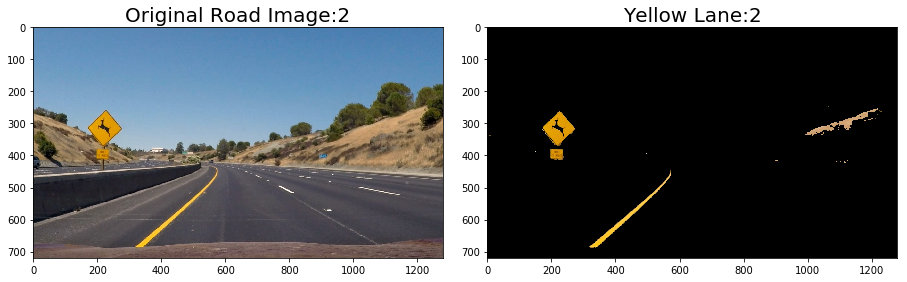

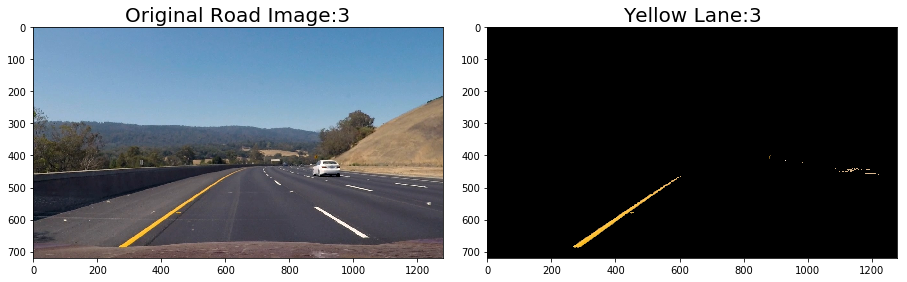

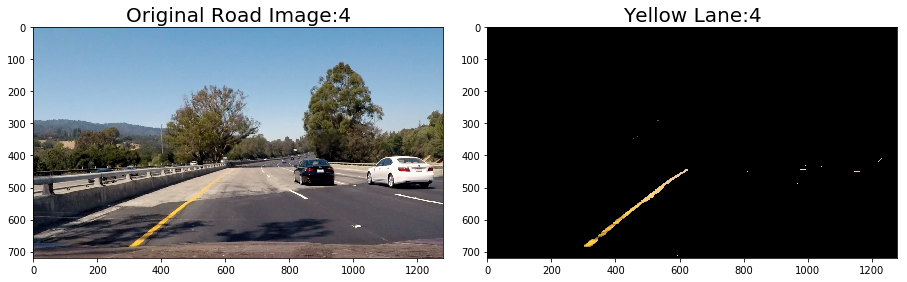

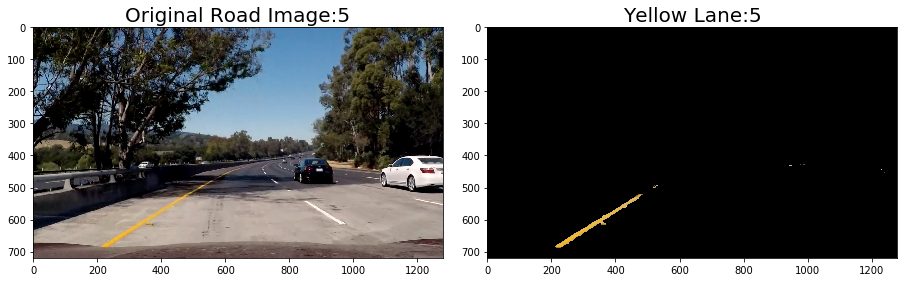

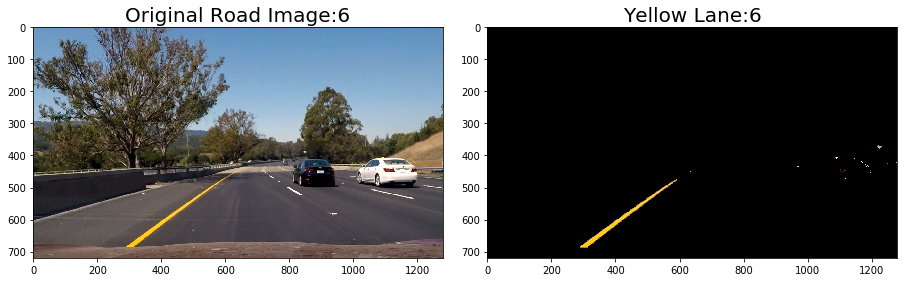

In [14]:
lower_yellow = np.array([0, 70, 112])
upper_yellow = np.array([45, 228, 255]) 
for i, fimg in enumerate(road_images):
    img = cv2.imread(fimg)
    yellow = pick_yellow(img, lower_yellow, upper_yellow)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))
    f.tight_layout()
    ax1.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    ax1.set_title('Original Road Image:'+str(i+1), fontsize=20)
    ax2.imshow(cv2.cvtColor(yellow, cv2.COLOR_BGR2RGB))
    ax2.set_title('Yellow Lane:'+str(i+1), fontsize=20)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)    
    f.savefig(os.path.join(img_save_path, 'yellow_lane'+str(i+1)+'.jpg'))

Finally I chose to use HLS space. The results above are pretty good. The next step is to pick white lanes. Now, for white lanes, we can just select pixels with high RBG values in the RGB space.

In [15]:
def pick_white(img, lower_white, upper_white, return_binary=False):
    # Threshold the BGR image to get only white colors
    mask = cv2.inRange(img, lower_white, upper_white)
    # Bitwise-AND mask and original image
    res = cv2.bitwise_and(img, img, mask= mask)
    if return_binary:
        return mask
    else:
        return res

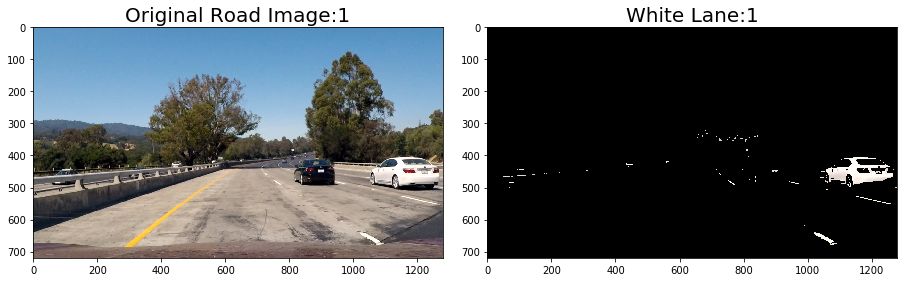

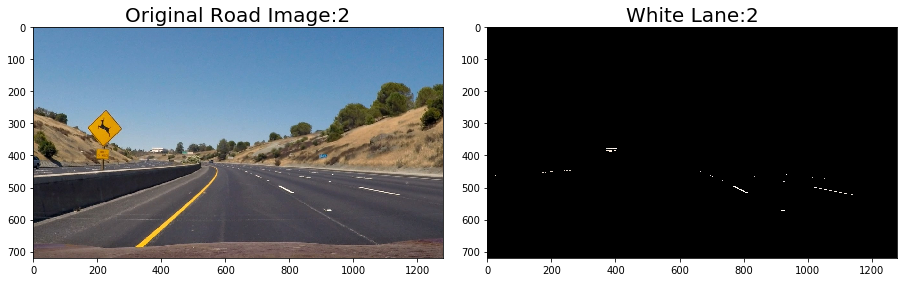

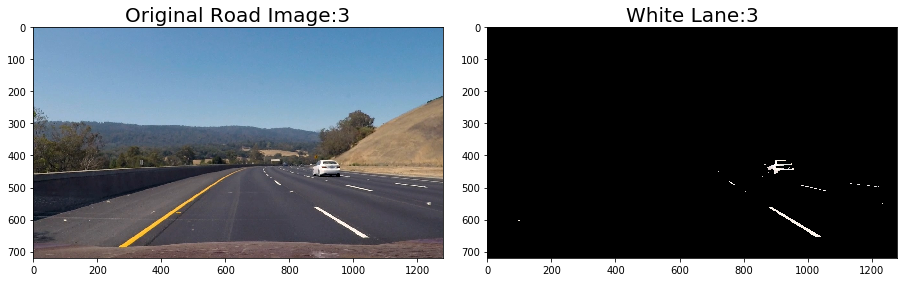

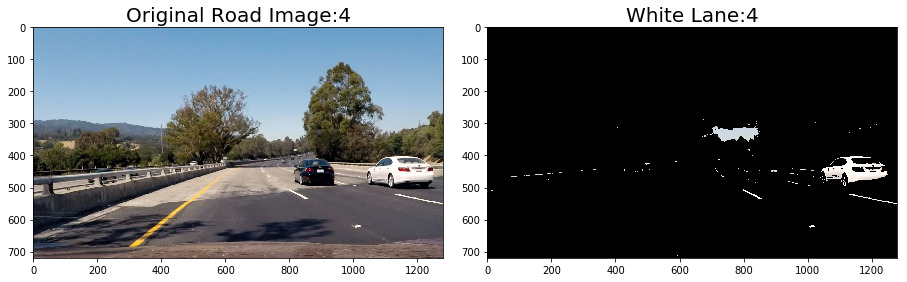

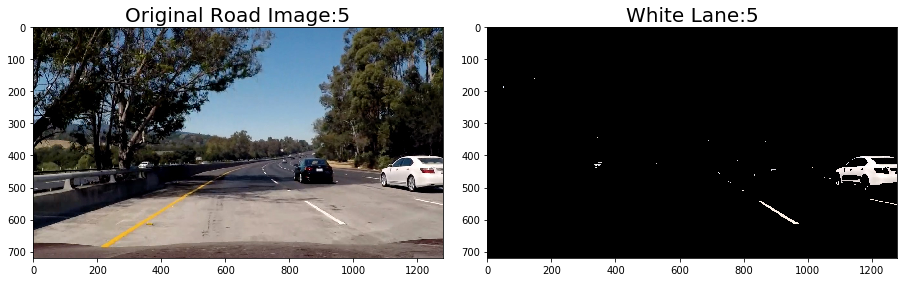

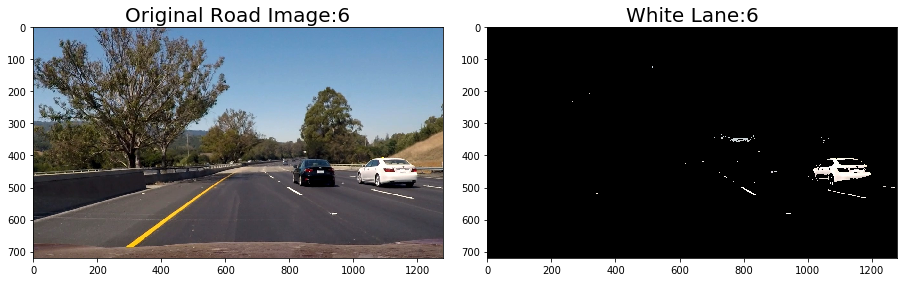

In [16]:
lower_white = np.array([200, 200, 200])
upper_white = np.array([255, 255, 255]) 
for i, fimg in enumerate(road_images):
    img = cv2.imread(fimg)
    white = pick_white(img, lower_white, upper_white)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))
    f.tight_layout()
    ax1.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    ax1.set_title('Original Road Image:'+str(i+1), fontsize=20)
    ax2.imshow(cv2.cvtColor(white, cv2.COLOR_BGR2RGB))
    ax2.set_title('White Lane:'+str(i+1), fontsize=20)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    f.savefig(os.path.join(img_save_path, 'white_lane'+str(i+1)+'.jpg'))

Next, combine white and yellow lane selection.

In [17]:
def pick_white_yellow(img, lower_yellow, upper_yellow, lower_white, upper_white, return_binary=False):
    white = pick_white(img, lower_white, upper_white, True)
    yellow = pick_yellow(img, lower_yellow, upper_yellow, True)
    color_mask = cv2.bitwise_or(white, yellow)
    res = cv2.bitwise_and(img, img, mask = color_mask)
    if return_binary:
        return color_mask
    else:
        return res

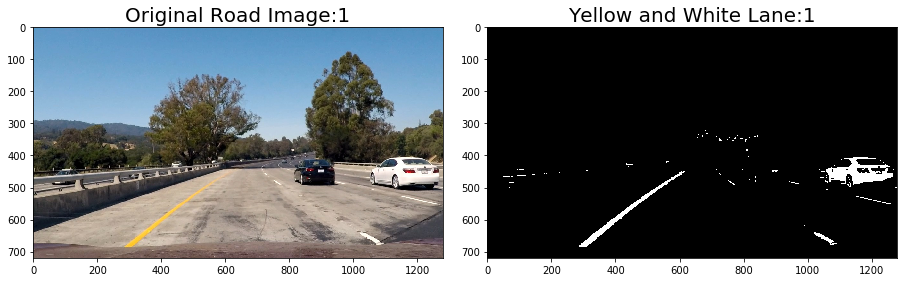

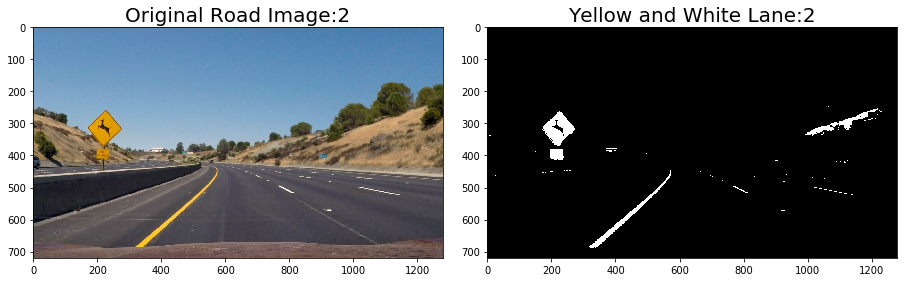

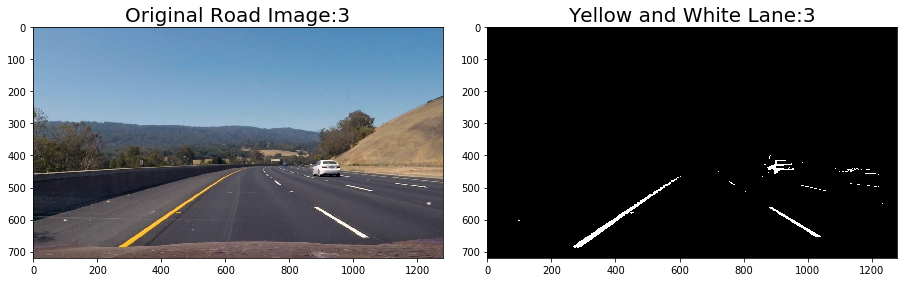

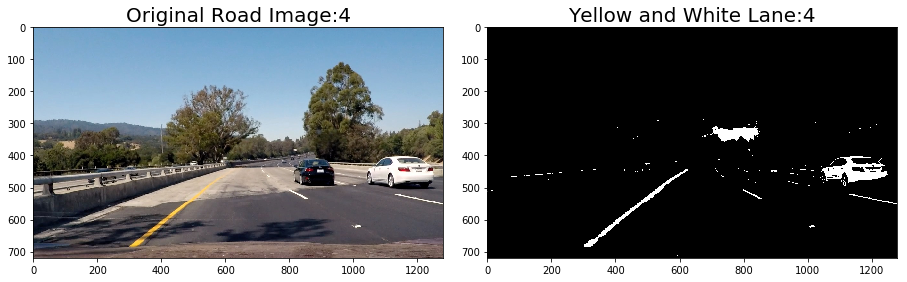

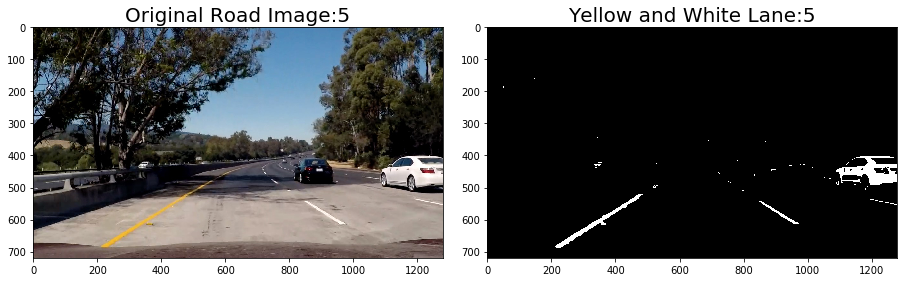

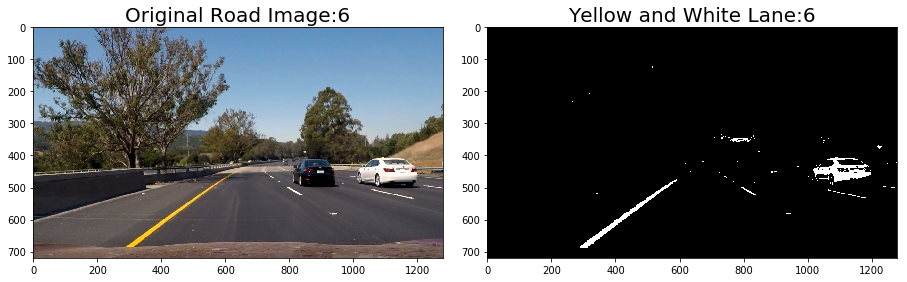

In [18]:
lower_yellow = np.array([0, 70, 112])
upper_yellow = np.array([45, 228, 255]) 
lower_white = np.array([200, 200, 200])
upper_white = np.array([255, 255, 255]) 
for i, fimg in enumerate(road_images):
    img = cv2.imread(fimg)
    lane = pick_white_yellow(img, lower_yellow, upper_yellow, lower_white, upper_white, True)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))
    f.tight_layout()
    ax1.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    ax1.set_title('Original Road Image:'+str(i+1), fontsize=20)
    ax2.imshow(lane, cmap='gray')
    ax2.set_title('Yellow and White Lane:'+str(i+1), fontsize=20)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    f.savefig(os.path.join(img_save_path, 'yellow_and_white'+str(i+1)+'.jpg'))

In fact, just by properly thresholding the colors, we have successfully isolately most lane markings from the rest of the image. Let's see if using sobel gradient selector will give us more contents.

In [19]:
def sobel_x_gradient(img, k_threshold, return_binary=False):
    r_channel = img[:,:,2]
    # Sobel x
    sobelx = cv2.Sobel(r_channel, cv2.CV_64F, 1, 0, ksize=9) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobelx = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    # Threshold x gradient
    sxbinary = np.zeros_like(scaled_sobelx)
    sxbinary[(scaled_sobelx >= k_threshold[0]) & (scaled_sobelx <= k_threshold[1])] = 1
    
    res = cv2.bitwise_and(img, img, mask = sxbinary)
    if return_binary:
        return sxbinary
    else:
        return res

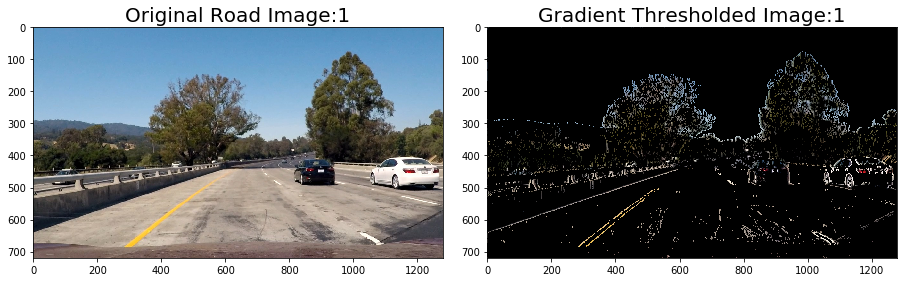

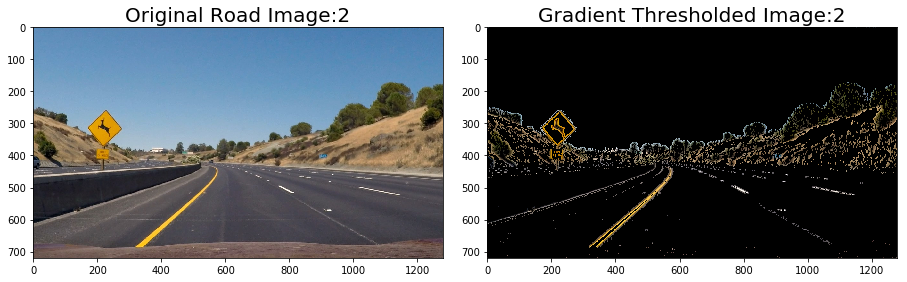

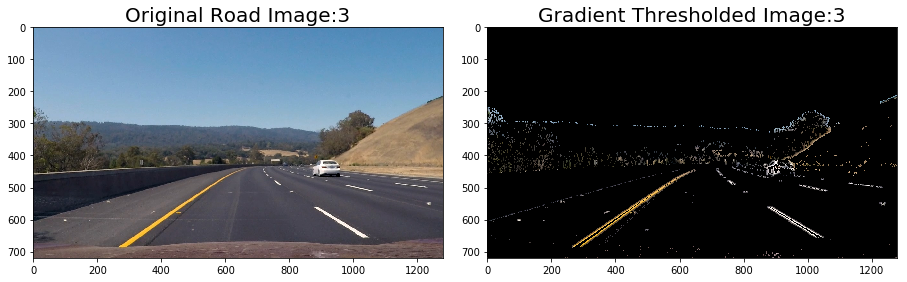

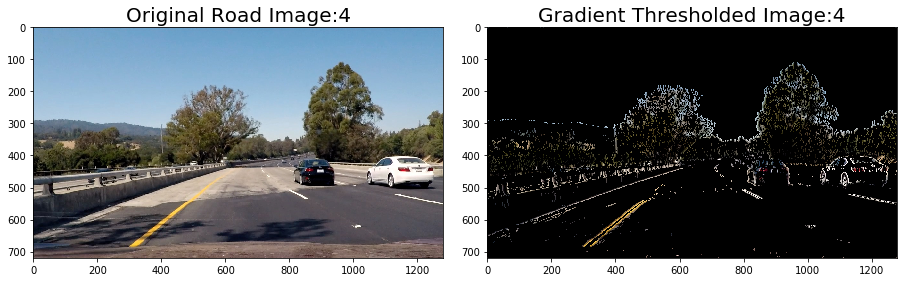

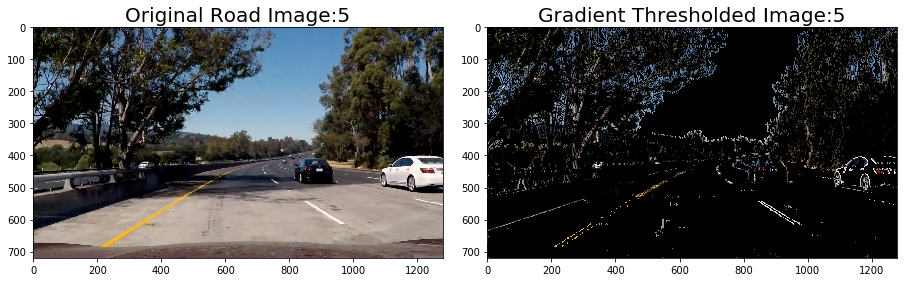

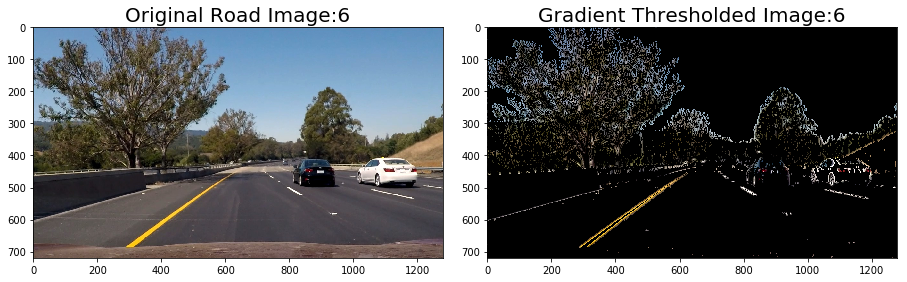

In [20]:
sobel_x_threshold = [20, 255]
for i, fimg in enumerate(road_images):
    img = cv2.imread(fimg)
    grad = sobel_x_gradient(img, sobel_x_threshold)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))
    f.tight_layout()
    ax1.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    ax1.set_title('Original Road Image:'+str(i+1), fontsize=20)
    ax2.imshow(cv2.cvtColor(grad, cv2.COLOR_BGR2RGB))
    ax2.set_title('Gradient Thresholded Image:'+str(i+1), fontsize=20)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    f.savefig(os.path.join(img_save_path, 'sobelx'+str(i+1)+'.jpg'))

It seems like we do get a little bit more information with sobel operator. However, it almost seems to be too much. Now, use a direction filter to narrow down our selections.

In [21]:
def _sobel_dir_gradient(img, threshold=[0, np.pi/2], return_binary=False):
    r_channel = img[:,:,2]
    # Sobel x
    sobelx = cv2.Sobel(r_channel, cv2.CV_64F, 1, 0, ksize=9) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    # Sobel y
    sobely = cv2.Sobel(r_channel, cv2.CV_64F, 0, 1, ksize=9) # Take the derivative in y
    abs_sobely = np.absolute(sobely) # Absolute y derivative to accentuate lines away from horizontal
    
    absgraddir = np.arctan2(abs_sobely, abs_sobelx)
    binary_output =  np.zeros_like(absgraddir)
    binary_output[(absgraddir >= threshold[0]) & (absgraddir <= threshold[1])] = 1
    res = cv2.bitwise_and(img, img, mask = np.dstack((binary_output, binary_output, binary_output)))
    if return_binary:
        return binary_output
    else:
        return res

In [22]:
def dir_threshold(img, sobel_kernel=3, thresh=[.7, 1.3]):
    # Grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    r_channel = img[:,:,2]
    # Calculate the x and y gradients
    sobelx = cv2.Sobel(r_channel, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(r_channel, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Take the absolute value of the gradient direction, 
    # apply a threshold, and create a binary image result
    absgraddir = np.arctan2(np.absolute(sobely), np.absolute(sobelx))
    binary_output =  np.zeros_like(absgraddir)
    binary_output[(absgraddir >= thresh[0]) & (absgraddir <= thresh[1])] = 1
    # Return the binary image
    return binary_output

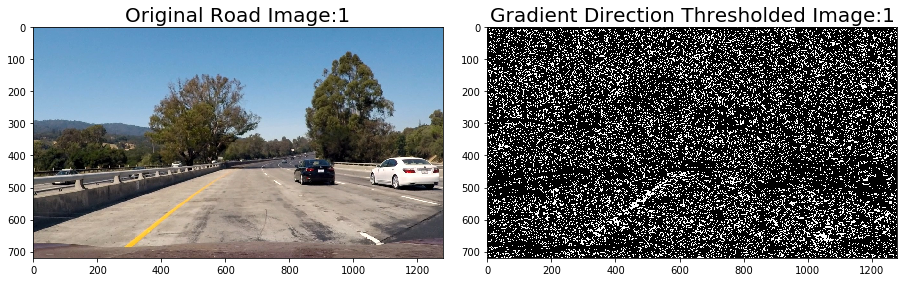

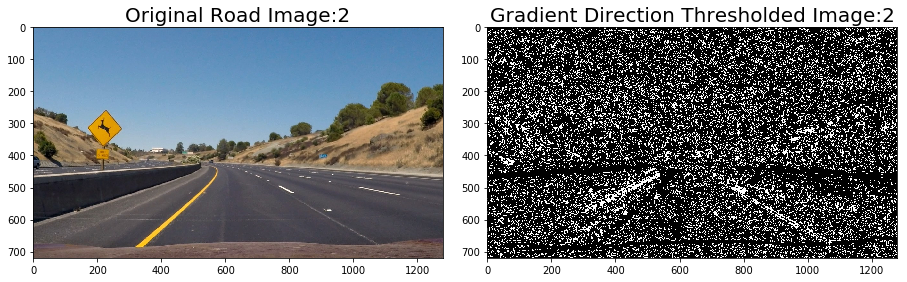

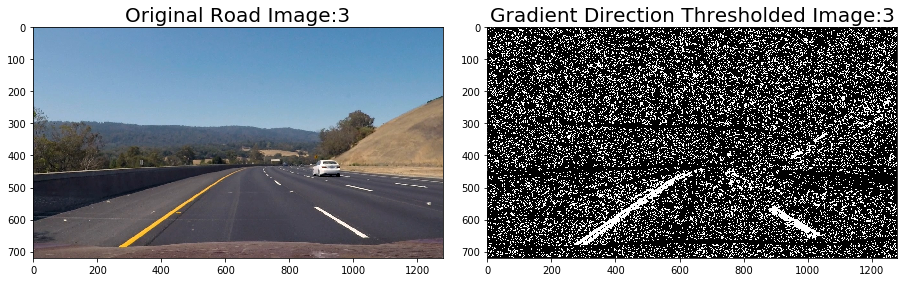

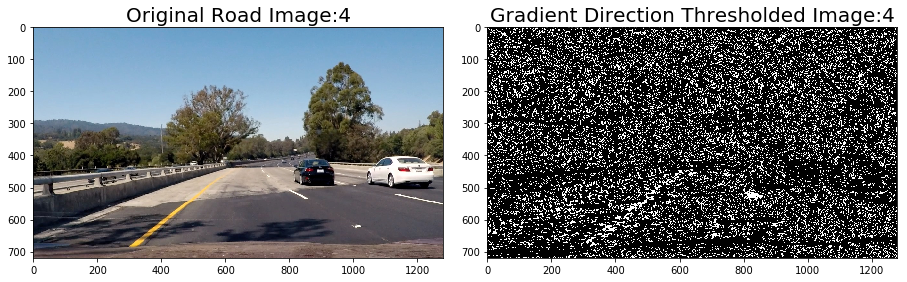

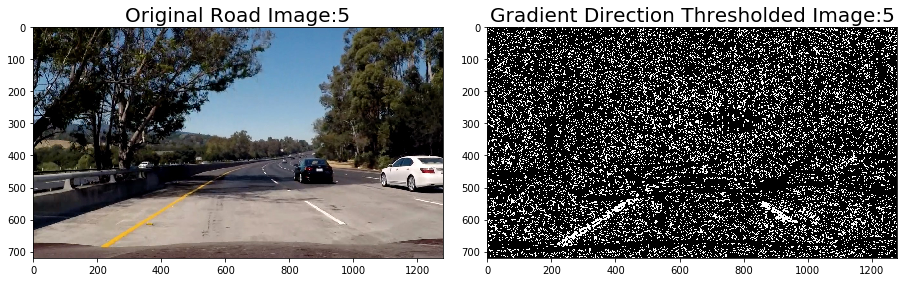

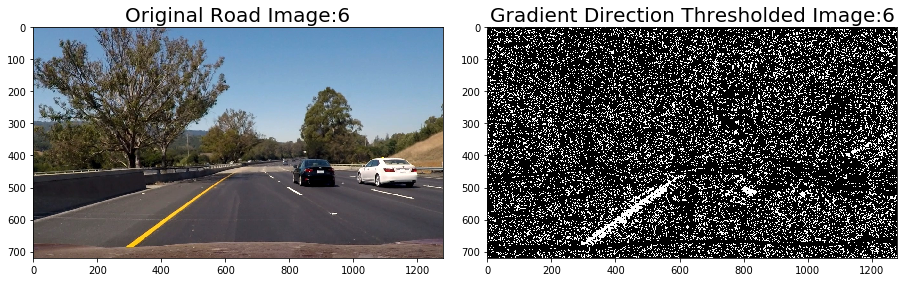

In [23]:
ang_threshold = [0.9, 1.2]
for i, fimg in enumerate(road_images):
    img = cv2.imread(fimg)
    grad_dir = dir_threshold(img, 21, ang_threshold)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))
    f.tight_layout()
    ax1.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    ax1.set_title('Original Road Image:'+str(i+1), fontsize=20)
    ax2.imshow(grad_dir, cmap='gray')
    ax2.set_title('Gradient Direction Thresholded Image:'+str(i+1), fontsize=20)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    f.savefig(os.path.join(img_save_path, 'sobel_dir'+str(i+1)+'.jpg'))

It is alright to see a bit noisier results. The idea here is to threshold the image such that we can identify lanes in the binary image. Next, combine the two selectors based on sobel operator.

In [24]:
def combined_gradient(img, k_threshold=[20, 255], ang_threshold=[0.9, 1.2], kernel_size=15):
    sobelx = sobel_x_gradient(img, k_threshold, True)
    grad_dir = dir_threshold(img, kernel_size, ang_threshold)
    binary_output =  np.zeros_like(sobelx)
    binary_output[(sobelx == 1) & (grad_dir == 1)] = 1
    
    return binary_output

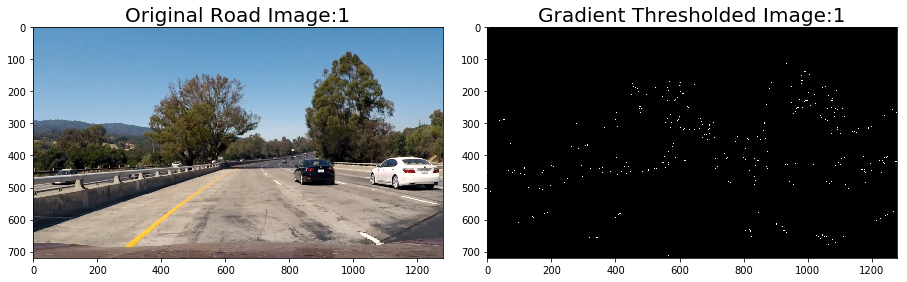

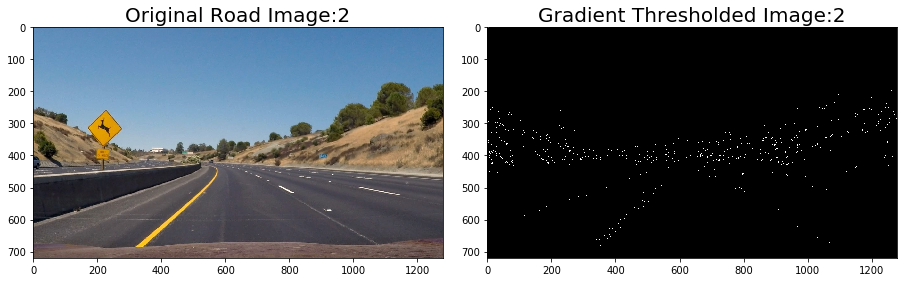

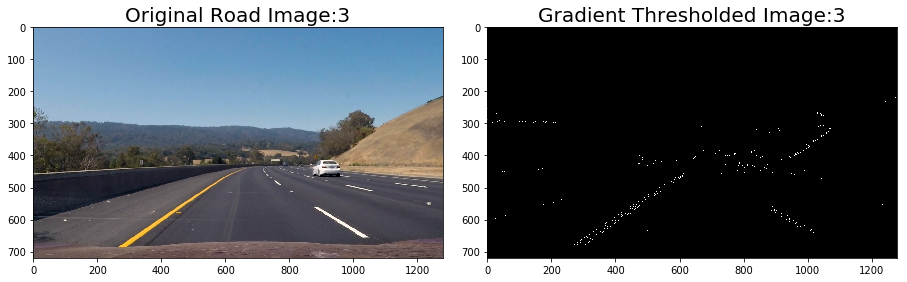

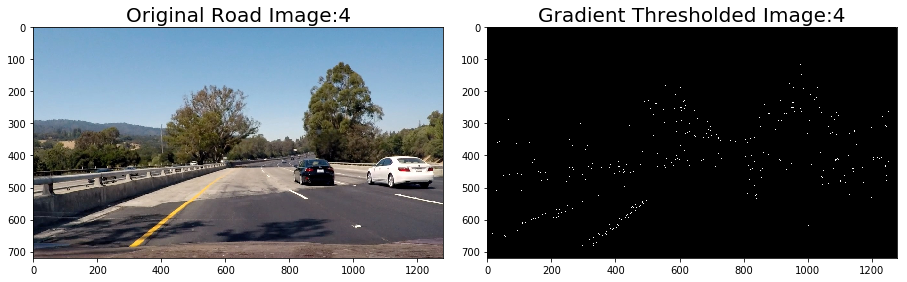

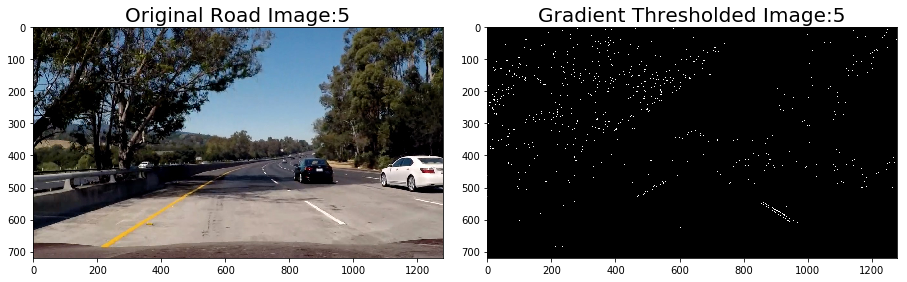

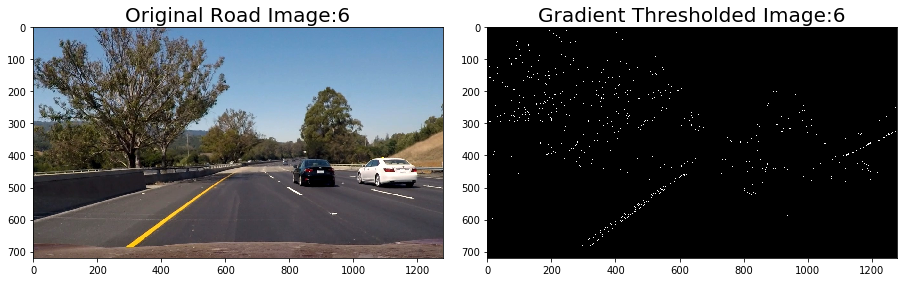

In [25]:
sobel_x_threshold = [30, 50]
ang_threshold = [0.9, 1.1]
kernel_size = 7
for i, fimg in enumerate(road_images):
    img = cv2.imread(fimg)
    combo = combined_gradient(img, sobel_x_threshold, ang_threshold, kernel_size)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))
    f.tight_layout()
    ax1.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    ax1.set_title('Original Road Image:'+str(i+1), fontsize=20)
    ax2.imshow(combo, cmap='gray')
    ax2.set_title('Gradient Thresholded Image:'+str(i+1), fontsize=20)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    f.savefig(os.path.join(img_save_path, 'comb_grad'+str(i+1)+'.jpg'))

Now, it is time to combine the color and gradient thresholds and produce the final results.

In [26]:
def binary_img(img, lower_yellow, upper_yellow, lower_white, upper_white, 
               k_threshold=[20, 255], ang_threshold=[0.9, 1.2], kernel_size=15):
    color_binary = pick_white_yellow(img, lower_yellow, upper_yellow, lower_white, upper_white, True)
    gradient_binary = combined_gradient(img, k_threshold, ang_threshold, kernel_size)
    binary_output =  np.zeros_like(color_binary)
    binary_output[(color_binary/255 == 1) |  (gradient_binary == 1)] = 1   
    return binary_output

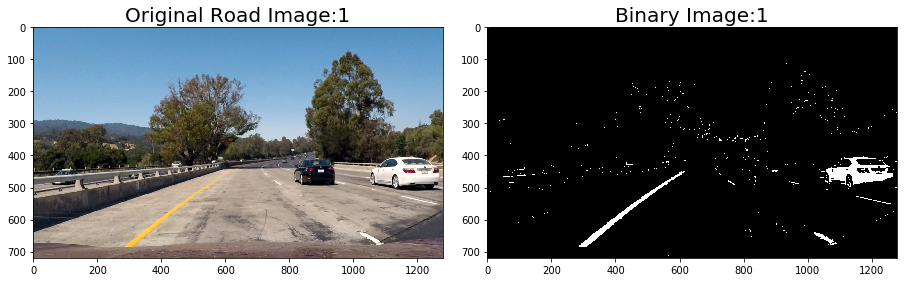

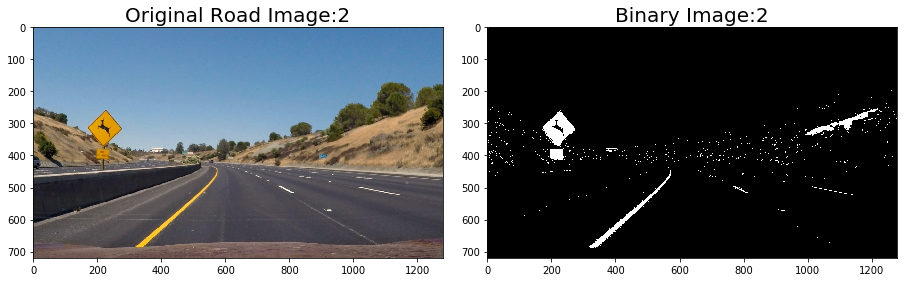

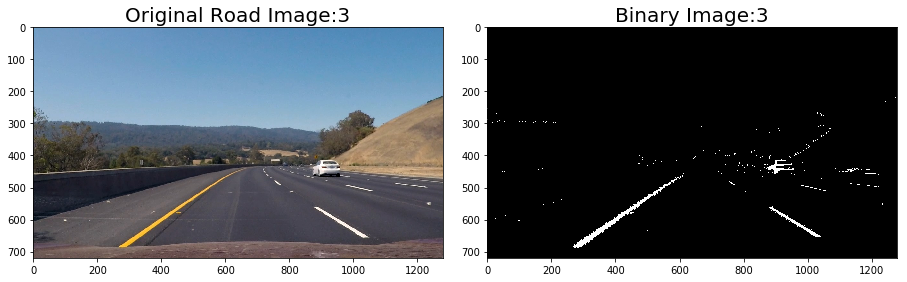

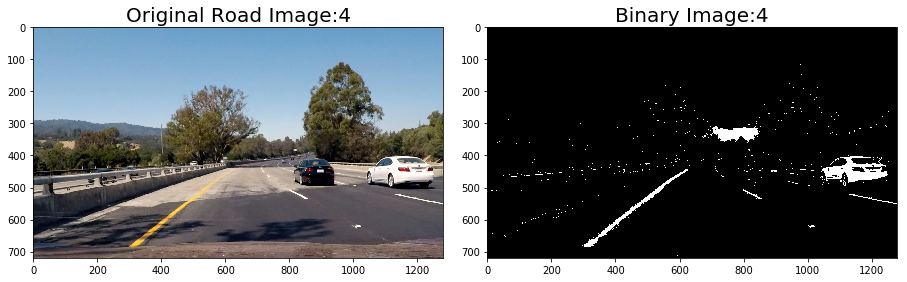

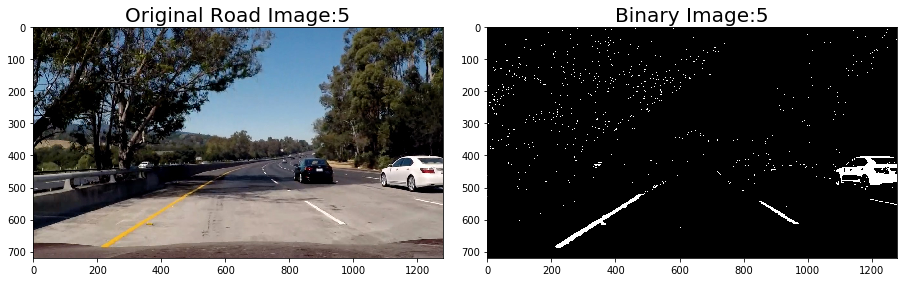

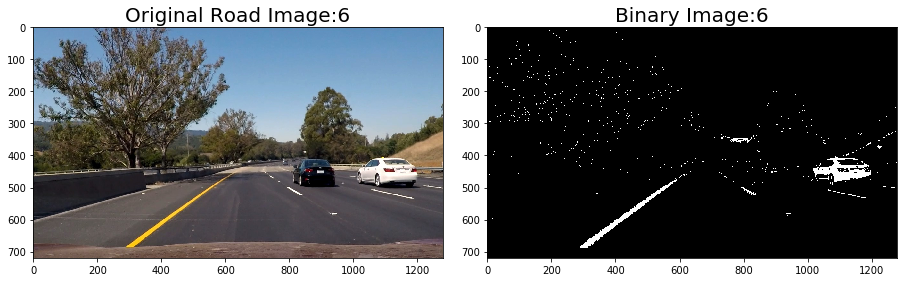

In [27]:
lower_yellow = np.array([0, 70, 112])
upper_yellow = np.array([45, 228, 255]) 
lower_white = np.array([200, 200, 200])
upper_white = np.array([255, 255, 255]) 
sobel_x_threshold = [30, 50]
ang_threshold = [0.9, 1.1]
kernel_size = 7
for i, fimg in enumerate(road_images):
    img = cv2.imread(fimg)
    bin_img = binary_img(img, lower_yellow, upper_yellow, lower_white, upper_white,
                         sobel_x_threshold, ang_threshold, kernel_size)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))
    f.tight_layout()
    ax1.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    ax1.set_title('Original Road Image:'+str(i+1), fontsize=20)
    ax2.imshow(bin_img, cmap='gray')
    ax2.set_title('Binary Image:'+str(i+1), fontsize=20)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    f.savefig(os.path.join(img_save_path, 'bin_img'+str(i+1)+'.jpg'))

## Apply perspective transform to image

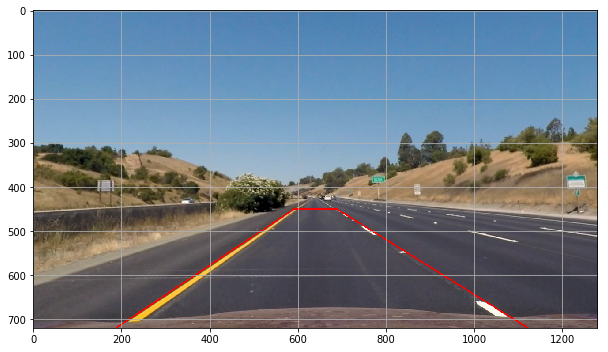

In [28]:
# use straight line image
straight1 = cv2.imread('./test_images/straight_lines1.jpg')
undist_straight1 = cal_undistort(straight1, objpoints, imgpoints)
# define a function that draws the region of interest on the image
def draw_region(img, v1, v2, v3, v4):
    img = np.copy(img)
    cv2.line(img, v1, v2, color=[0, 0, 255], thickness=2)
    cv2.line(img, v2, v3, color=[0, 0, 255], thickness=2)
    cv2.line(img, v3, v4, color=[0, 0, 255], thickness=2)
    cv2.line(img, v4, v1, color=[0, 0, 255], thickness=2)
    return img
# pick vertices
v1 = (187, undist_straight1.shape[0])
v2 = (591, 450)
v3 = (688, 450)
v4 = (1122, undist_straight1.shape[0])
# draw polygon on the image
region1 = draw_region(undist_straight1, v1, v2, v3, v4)
fig, ax = plt.subplots(figsize=(12, 5))
fig.tight_layout()
ax.imshow(cv2.cvtColor(region1, cv2.COLOR_BGR2RGB))
ax.grid()
fig.savefig(os.path.join(img_save_path, 'vertices.jpg'))

In [29]:
# define a function to warp the image to change perspective to birds eye view
def warp(img):
    '''Compute perspective transformation M and its inverse and a warped image
    
    Keyword arguments:
    img -- input image
    '''
    img = np.copy(img)
    img_size = (img.shape[1], img.shape[0])
    # source points
    src = np.float32([v1, v2, v3, v4])
    # desination points
    dst = np.float32([[450, img.shape[0]], [450, 0], [img.shape[1]-450, 0], [img.shape[1]-450, img.shape[0]]])
    # get transformation matrix M
    M = cv2.getPerspectiveTransform(src, dst)
    # get inverse transformation matrix invM
    invM = cv2.getPerspectiveTransform(dst, src)
    # create warped image
    warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_LINEAR)
    return (M, invM, warped)

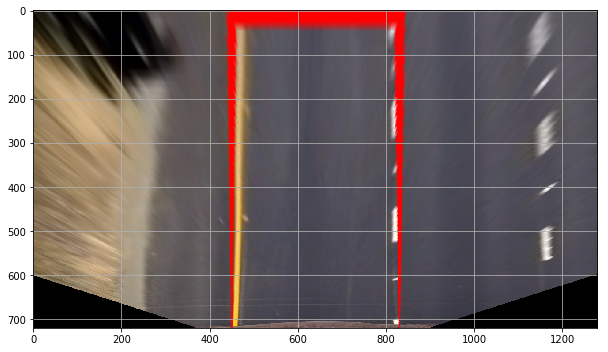

In [30]:
# test on straight line image
M, invM, warped1 = warp(region1)
fig, ax = plt.subplots(figsize=(12, 5))
fig.tight_layout()
ax.imshow(cv2.cvtColor(warped1, cv2.COLOR_BGR2RGB))
ax.grid()
fig.savefig(os.path.join(img_save_path, 'warped.jpg'))

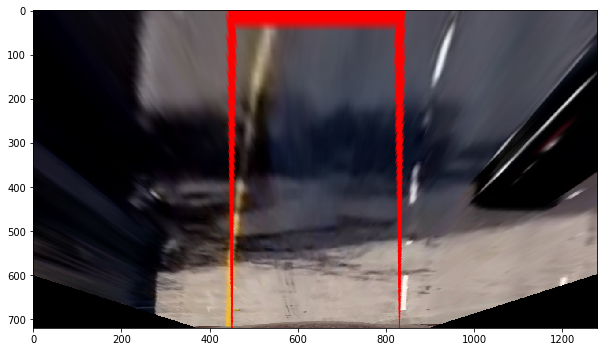

In [31]:
# test on curved image
curve_img = cv2.imread('./test_images/test5.jpg')
undist_curve_img = cal_undistort(curve_img, objpoints, imgpoints)
region2 = draw_region(undist_curve_img, v1, v2, v3, v4)
warped2 = warp(region2)[2]
fig, ax = plt.subplots(figsize=(12, 5))
fig.tight_layout()
ax.imshow(cv2.cvtColor(warped2, cv2.COLOR_BGR2RGB))
fig.savefig(os.path.join(img_save_path, 'warped2.jpg'))

Now that we can confirm the perspective transformation works, it is time to sum up all the steps we have achieved and define a function that takes in a camera image, undistort it, threshold it and returns a warped binary image in birds-eye view.

In [32]:
# define a mask function to show only region of interest
def mask(img, vertices):
    """Applies an image mask. Only keeps the region of the image defined by the polygonformed from `vertices`. 
    The rest of the image is set to black.
    
    Keyword arguments:
    img -- input image
    vertices -- vertices that defines a region
    """
    #defining a blank mask to start with
    mask = np.zeros_like(img)   
    
    #defining a 3 channel or 1 channel color to fill the mask with depending on the input image
    if len(img.shape) > 2:
        channel_count = img.shape[2]  # i.e. 3 or 4 depending on your image
        ignore_mask_color = (255,) * channel_count
    else:
        ignore_mask_color = 255
        
    #filling pixels inside the polygon defined by "vertices" with the fill color    
    cv2.fillPoly(mask, vertices, ignore_mask_color)
    
    #returning the image only where mask pixels are nonzero
    masked_image = cv2.bitwise_and(img, mask)
    return masked_image

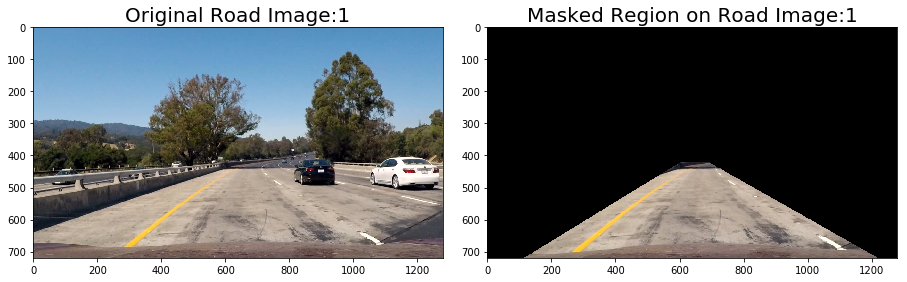

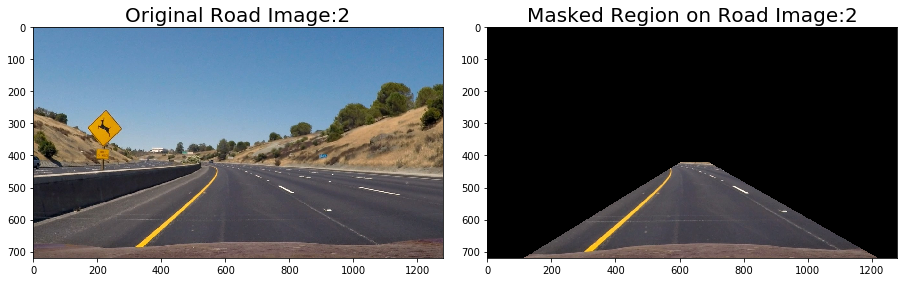

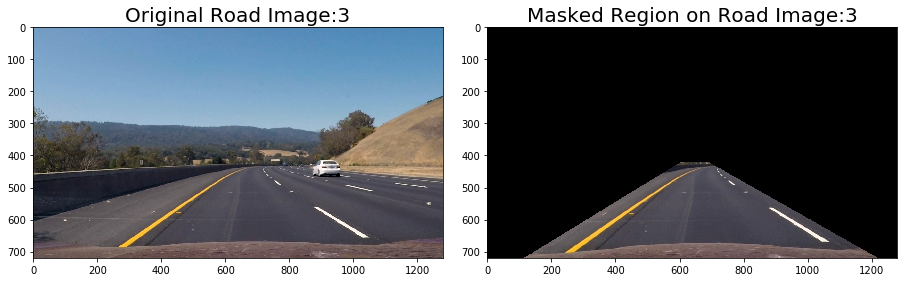

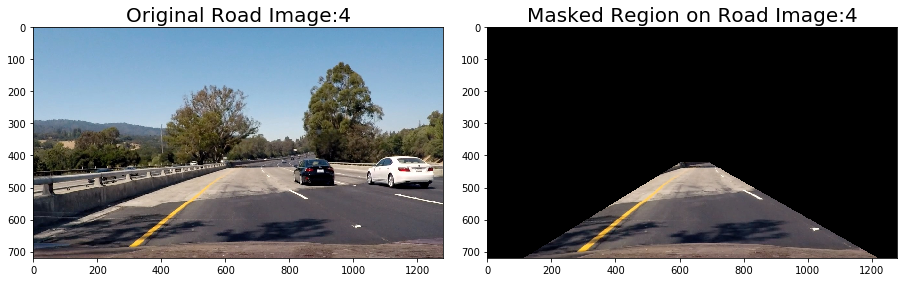

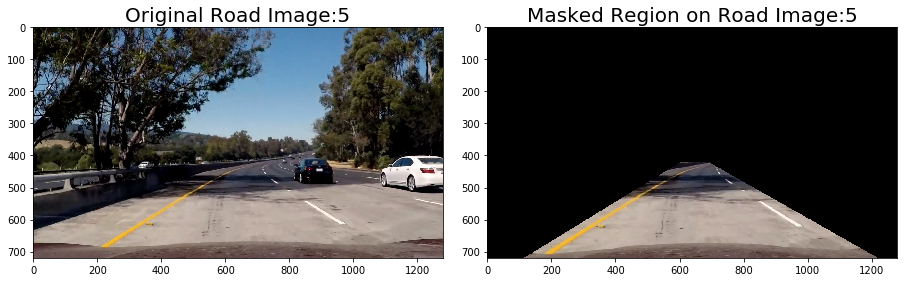

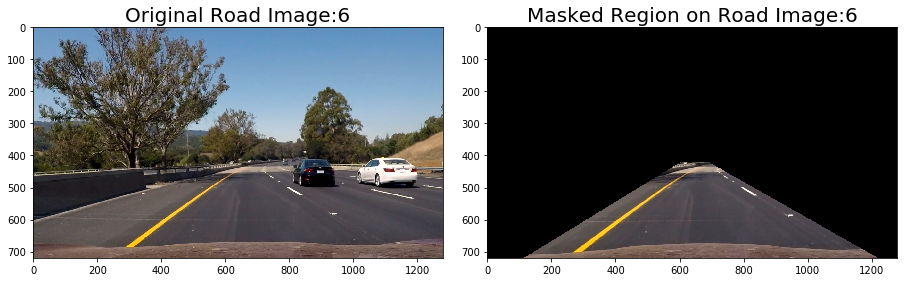

In [33]:
mask_vertices = np.array([[(115, 720),(605, 420), (690, 420), (1220, 720)]], dtype=np.int32)
# make sure the region works on test images
for i, fimg in enumerate(road_images):
    img = cv2.imread(fimg)
    undist = cal_undistort(img, objpoints, imgpoints)
    region = mask(undist, mask_vertices)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))
    f.tight_layout()
    ax1.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    ax1.set_title('Original Road Image:'+str(i+1), fontsize=20)
    ax2.imshow(cv2.cvtColor(region, cv2.COLOR_BGR2RGB))
    ax2.set_title('Masked Region on Road Image:'+str(i+1), fontsize=20)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    f.savefig(os.path.join(img_save_path, 'region_road_image'+str(i+1)+'.jpg'))

In [34]:
def warped_binary(img, objpoints, imgpoints, lower_yellow, upper_yellow, lower_white, upper_white, 
                  sobel_x_threshold=[30, 50], ang_threshold=[0.9, 1.1], kernel_size=7):
    '''Undistort, threshold and warp an input image
    
    Keyword arguments:
    img -- input image
    objpoints -- 3d points in real world space
    imgpoints -- 2d points in image plane
    lower_yellow -- lower threshold for yellow
    upper_yellow -- upper threshold for yellow
    lower_white -- lower threshold for white
    upper_white -- upper threshold for white    
    sobel_x_threshold -- threshold for x gradient
    ang_threshold -- threhold for gradient direction
    kernel_size -- sobel operator kernel size
    '''
    img = np.copy(img)
    # undistort
    undist = cal_undistort(img, objpoints, imgpoints)
    
    # mask
    #masked_img = mask(undist, vertices)
    # threshold
    bin_img = binary_img(img, lower_yellow, upper_yellow, lower_white, upper_white,
                         sobel_x_threshold, ang_threshold, kernel_size)
    # draw region
    #region = draw_region(bin_img, v1, v2, v3, v4)
    # mask
    masked_bin = mask(bin_img, mask_vertices)
    # warp
    M, invM, warped = warp(masked_bin)
    return M, invM, warped, undist

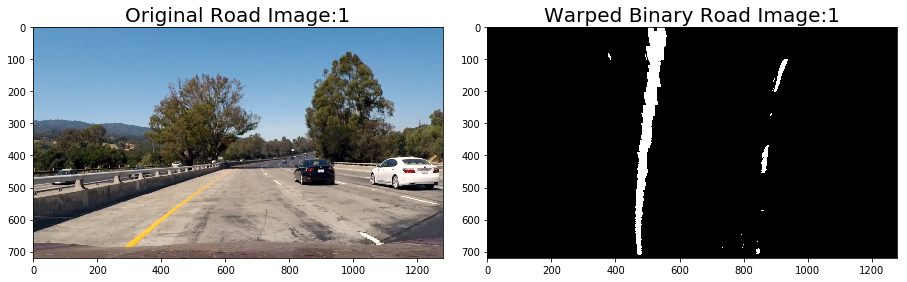

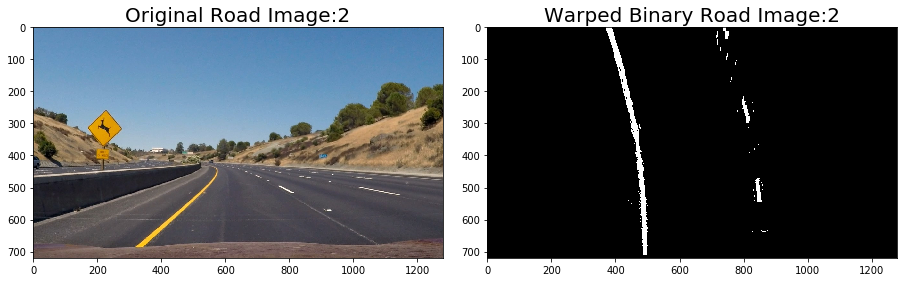

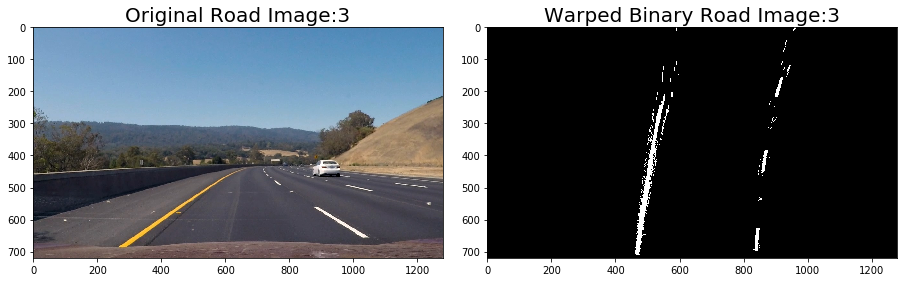

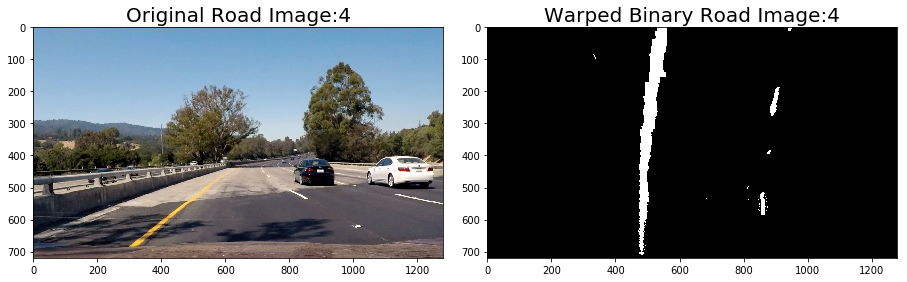

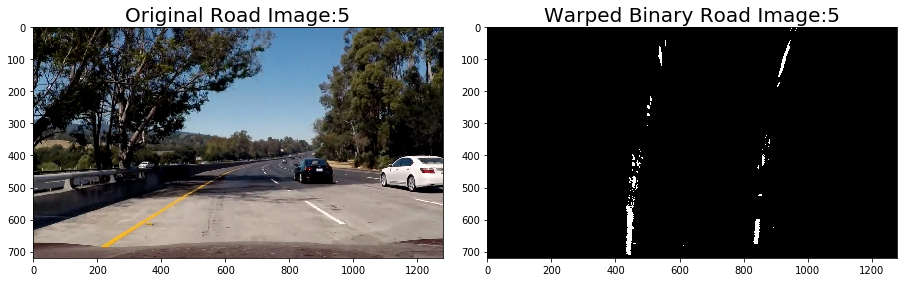

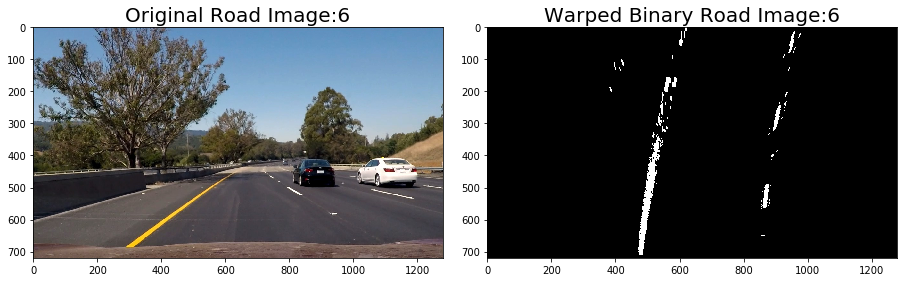

In [35]:
# test the function on test images
# repeat parameter definition for tuning

lower_yellow = np.array([0, 70, 112])
upper_yellow = np.array([45, 228, 255]) 
lower_white = np.array([200, 200, 200])
upper_white = np.array([255, 255, 255]) 
sobel_x_threshold = [30, 50]
ang_threshold = [0.9, 1.1]
kernel_size = 7


for i, fimg in enumerate(road_images):
    img = cv2.imread(fimg)
    bin_warped = warped_binary(img, objpoints, imgpoints, lower_yellow, upper_yellow, lower_white, upper_white, 
                               sobel_x_threshold, ang_threshold, kernel_size)[2]
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))
    f.tight_layout()
    ax1.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    ax1.set_title('Original Road Image:'+str(i+1), fontsize=20)
    ax2.imshow(bin_warped, cmap='gray')
    ax2.set_title('Warped Binary Road Image:'+str(i+1), fontsize=20)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    f.savefig(os.path.join(img_save_path, 'warped_binary_road_image'+str(i+1)+'.jpg'))

## Find lanes in the binary image

In [36]:
# define a sliding window function to find lanes
def sliding_window_search(binary_warped, nwindows, margin, minpix, visualize = False):
    '''Find lanes in a binary warped image
    
    Keyword arguments:
    binary_warped -- input binary image and already warped into top view
    nwindows -- number of sliding windows
    margin -- width of windows, +/- margin
    minpix -- minimum number of pixels found to recenter the window
    visualize -- boolean value to turn on visualization, for testing only
    '''
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[int(binary_warped.shape[0]/2):,:], axis=0)
    # Create an output image to draw on and  visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]/2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # Choose the number of sliding windows
    #nwindows = 12
    # Set height of windows
    window_height = np.int(binary_warped.shape[0]/nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Set the width of the windows +/- margin
    #margin = 100
    # Set minimum number of pixels found to recenter window
    #minpix = 5
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        if visualize:
            # Draw the windows on the visualization image
            cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2) 
            cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2) 
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 

    # Fit a second order polynomial to each
    right_fit = np.polyfit(righty, rightx, 2)
    left_fit = np.polyfit(lefty, leftx, 2)
    
    
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
    if visualize: 
        plt.imshow(out_img)
        plt.plot(left_fitx, ploty, color='yellow')
        plt.plot(right_fitx, ploty, color='yellow')
        plt.xlim(0, 1280)
        plt.ylim(720, 0)
        
    return ploty, left_fitx, right_fitx, out_img, lefty, leftx, righty, rightx

In [37]:
# define a function to draw lanes area on the original undistorted image
def visualize_lane(undist, binary_warped, lane, invM):
    ''' Visualize lanes on an undistorted image.
    
    Keyword arguments:
    undist -- an undistorted image
    binary_warped -- a binary warped image
    lane -- [ploty, left_fitx, right_fitx]
    invM -- inverse transform matrix to unwarp image
    '''
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(binary_warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))
    ploty = lane[0]
    left_fitx = lane[1]
    right_fitx = lane[2]
    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw area inside the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

    # Warp the blank back to original image space using inverse perspective matrix (invM)
    newwarp = cv2.warpPerspective(color_warp, invM, (binary_warped.shape[1], binary_warped.shape[0])) 
    # Combine the result with the original image
    result = cv2.addWeighted(undist, 1, newwarp, 0.3, 0)
    #plt.imshow(result) 
    return result

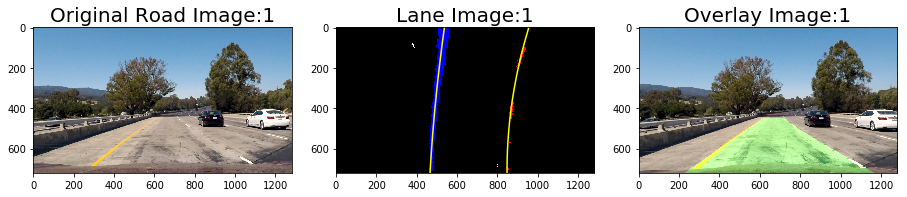

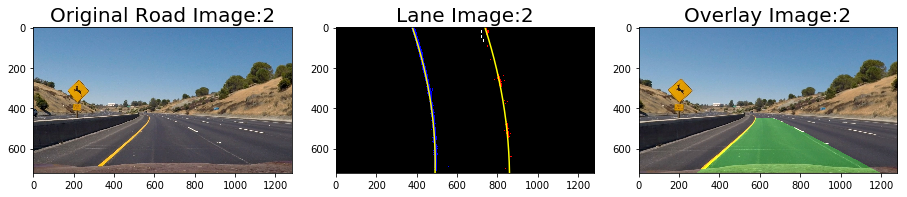

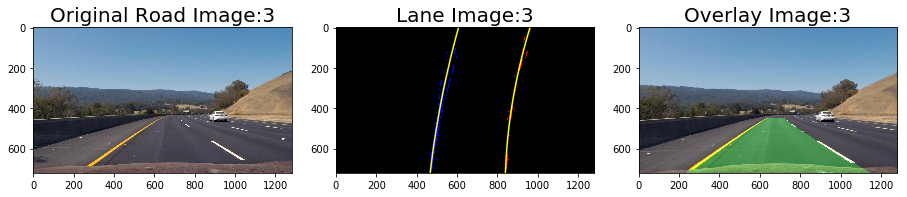

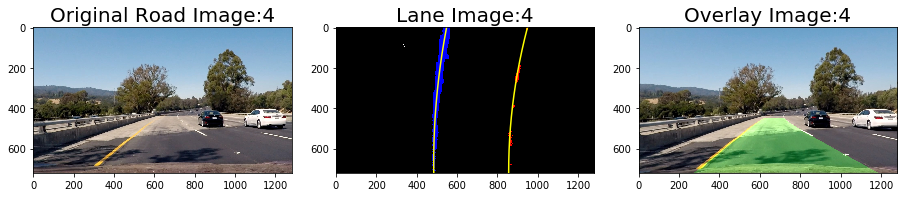

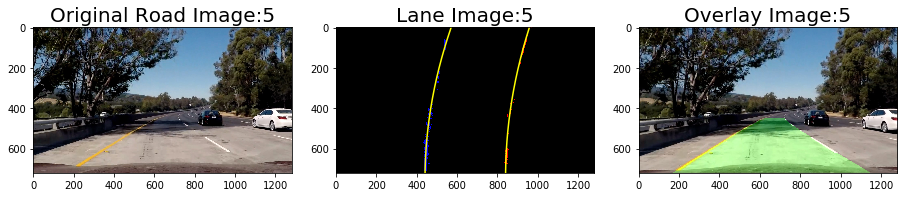

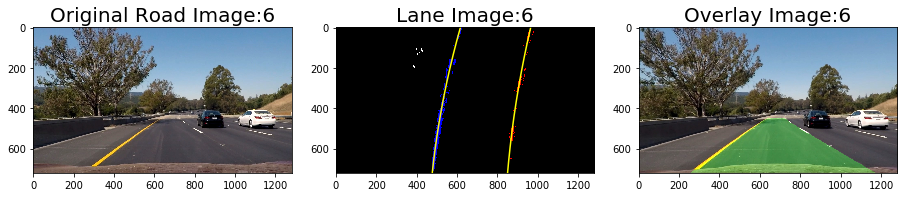

In [38]:
# test on road images
nwindows = 16 
margin = 70
minpix = 100
for i, fimg in enumerate(road_images):
    img = cv2.imread(fimg)
    invM, bin_warped = warped_binary(img, objpoints, imgpoints, lower_yellow, upper_yellow, lower_white, upper_white, 
                                     sobel_x_threshold, ang_threshold, kernel_size)[1:3]
    lanes = sliding_window_search(bin_warped, nwindows, margin, minpix, visualize = False)
    visual = visualize_lane(cal_undistort(img, objpoints, imgpoints), bin_warped, lanes, invM)
    f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(12, 5))
    f.tight_layout()
    ax1.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    ax1.set_title('Original Road Image:'+str(i+1), fontsize=20)
    ax2.imshow(cv2.cvtColor(lanes[3], cv2.COLOR_BGR2RGB))
    ploty = lanes[0]
    left_fitx = lanes[1]
    right_fitx = lanes[2]
    ax2.plot(left_fitx, ploty, color='yellow')
    ax2.plot(right_fitx, ploty, color='yellow')
    ax2.set_title('Lane Image:'+str(i+1), fontsize=20)
    ax3.imshow(cv2.cvtColor(visual, cv2.COLOR_BGR2RGB))
    ax3.set_title('Overlay Image:'+str(i+1), fontsize=20)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    f.savefig(os.path.join(img_save_path, 'lanes_image'+str(i+1)+'.jpg'))

## Measure curvature of the lane and compute lateral offset

In [39]:
def process_lane_data(lane, img_shape, verbose=False):
    """Process left and right lane fitted data from binary image
    
    Return radius of curvature, offset from lane center, derivative of lanes at bottom max y
    
    keyword arguments:
    lane -- [ploty, left_fitx, right_fitx]
    img_shape -- [height, width]
    verbose -- debug control
    
    """
    ploty = lane[0]
    left_fitx = lane[1]
    right_fitx = lane[2]
    # evaluate curvature at the bottom of the image
    y_eval = np.max(ploty)
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension

    # Fit new polynomials to x,y in world space
    left_fit_cr = np.polyfit(ploty*ym_per_pix, left_fitx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(ploty*ym_per_pix, right_fitx*xm_per_pix, 2)
    
    # Calculate derivatives for parallelism check
    left_dot = 2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1]  
    right_dot = 2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1]
    
    # Calculate the new radii of curvature in meters
    left_curverad = ((1 + left_dot**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + right_dot**2)**1.5) / np.absolute(2*right_fit_cr[0])

    # Compute left and right lane at bottom of image
    left_bot_x = left_fitx[np.argmax(ploty)]
    right_bot_x = right_fitx[np.argmax(ploty)]
    
    # Compute lane center
    lane_center = (right_bot_x + left_bot_x) / 2
    # Compute camera location, assuming camera is mounted at center of vehicle
    camera_x = img_shape[1] / 2
    # Compute lateral offset, if offset > 0, vehicle deviates to the right, otherwise deviates to the left
    offset = camera_x - lane_center
    # Convert to real world unit
    offset = offset*xm_per_pix
    
    # Print for debugging
    if verbose:
        print("Left Lane Radius: {0:.2f} m, Right Lane Radius: {1:.2f} m" .format(left_curverad, right_curverad))
        if offset < 0:
            print("Offset: {:.2f} m left".format(offset))
        else:
            print("Offset: {:.2f} m right".format(offset))
    
    return left_curverad, right_curverad, left_dot, right_dot, offset 

In [40]:
for i, fimg in enumerate(road_images):
    img = cv2.imread(fimg)
    invM, bin_warped = warped_binary(img, objpoints, imgpoints, lower_yellow, upper_yellow, lower_white, upper_white, 
                                     sobel_x_threshold, ang_threshold, kernel_size)[1:3]
    lanes = sliding_window_search(bin_warped, nwindows, margin, minpix, visualize = False)
    lane_data = process_lane_data(lanes, img.shape, True)

Left Lane Radius: 2882.68 m, Right Lane Radius: 767.03 m
Offset: -0.09 m left
Left Lane Radius: 652.68 m, Right Lane Radius: 768.36 m
Offset: -0.19 m left
Left Lane Radius: 1452.26 m, Right Lane Radius: 876.82 m
Offset: -0.07 m left
Left Lane Radius: 1152.05 m, Right Lane Radius: 896.11 m
Offset: -0.16 m left
Left Lane Radius: 718.89 m, Right Lane Radius: 762.57 m
Offset: -0.00 m left
Left Lane Radius: 1338.34 m, Right Lane Radius: 1600.32 m
Offset: -0.12 m left


We can see that 4 out of 6 images give us very close left and right lane radii.

## Implement quick search

It is not necessary to run sliding window search for each image. Once a lane has been locked on in an image, for the image immedidately afterwards, we can use existing lane and search for lanes within a predefined margin.

In [41]:
def quick_search(binary_warped, margin, left_fit, right_fit):
    # select detected pixels
    nonzero = binary_warped.nonzero()
    # initialize x and y array
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # search for left lane pixels, x_old - margin <= x_new <= x_old + margin
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] + margin))) 
    # repeat for right lane pixels
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] + margin)))  

    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    # Create an output image to draw on and  visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]    
    return ploty, left_fitx, right_fitx, out_img, lefty, leftx, righty, rightx

## Result tracking and validation

Until now, only individual images are worked upon. In reality however, there is a continuous flow of images gathered by the camera. It is possible to do two things with that; first, it is possible to keep track of the lanes and other properties computed with previous images, and second, compare newly computed results with previous results to check the validity of the computation.

In [42]:
# define a function to validate newly detected lanes
def lane_validated(ploty, left_fitx, right_fitx, left_curverad, right_curverad, left_dot, right_dot, verbose=False):
    flag = True
    # check radius of curvature
    if left_curverad / right_curverad > 2 or left_curverad / right_curverad < 0.5:
        flag = False
        if verbose:
            print("Radius ratio", left_curverad / right_curverad)
            print("Radius check failed")
        return flag
    # check lane width, 300 pixels < lane width < 400 pixels
    left_bot_x = left_fitx[np.argmax(ploty)]
    right_bot_x = right_fitx[np.argmax(ploty)]
    if right_bot_x - left_bot_x > 400 or right_bot_x - left_bot_x < 300:
        flag = False
        if verbose:
            print("Lane width", right_bot_x - left_bot_x, "pixels")
            print("Lane width check failed")
        return flag
    # check parallelism
    if np.absolute(left_dot / right_dot) > 10 or np.absolute(left_dot / right_dot) < 0.1:    
        flag = False
        if verbose:
            print("Derivative ratio", left_dot / right_dot)
            print("Parallelism check failed")
        return flag
    return flag

In [43]:
# check validation function
for i, fimg in enumerate(road_images):
    img = cv2.imread(fimg)
    invM, bin_warped = warped_binary(img, objpoints, imgpoints, lower_yellow, upper_yellow, lower_white, upper_white, 
                                     sobel_x_threshold, ang_threshold, kernel_size)[1:3]
    lanes = sliding_window_search(bin_warped, nwindows, margin, minpix, visualize = False)
    lane_data = process_lane_data(lanes, img.shape, False)
    if lane_validated(*lanes[0:3], *lane_data[0:4], True):
        print("Image", i+1, "Valid lane detection.")
    else:
        print("Image", i+1, "Invalid lane detection.")    

Radius ratio 3.75822876875
Radius check failed
Image 1 Invalid lane detection.
Image 2 Valid lane detection.
Image 3 Valid lane detection.
Image 4 Valid lane detection.
Image 5 Valid lane detection.
Image 6 Valid lane detection.


It can be seen that the validation function produces results that correctly correspond to the form of detected lanes.

In [44]:
# define a class to receive the characteristics of each line detection
class Line():
    def __init__(self):
        # was the line detected in the last iteration?
        self.detected = False  
        # x values of the last 3 fits of the line
        self.recent_xfitted = []
        # average x values of the fitted line over the last 3 iterations
        self.bestx = []     
        # polynomial coefficients averaged over the last 3 iterations
        self.best_fit = None
        # polynomial coefficients for the most recent fit
        self.current_fit = [np.array([False])]  
        # radius of curvature of the line in some units
        self.radius_of_curvature = None 
        # distance in meters of vehicle center from the line
        self.offset = None 
        # difference in fit coefficients between last and new fits
        self.diffs = np.array([0,0,0], dtype='float') 
        # x values for detected line pixels
        self.allx = None  
        # y values for detected line pixels
        self.ally = None
    
    def update(self, ploty, fitx, curverad, dot, offset):
        """Use newly detected lane to update left and right lane object, once they pass the validation check

        Keyword arguments:
        lane -- a lane object, left or right
        ploty -- y values for fitting, returned from sliding window or quick search
        fitx -- x values for fitting, returned from sliding window or quick search
        curverad -- radius of curvature
        dot -- derivative of curve at bottom of the image
        offset -- offset from center of lane
        """
        self.detected = True
        if len(self.recent_xfitted) == 3:
            # delete oldest result
            self.recent_xfitted.pop(0)
        self.recent_xfitted.append(fitx)
        self.bestx = np.mean(self.recent_xfitted, axis=0)
        self.best_fit = np.polyfit(ploty, self.bestx, 2)
        self.current_fit = np.polyfit(ploty, fitx, 2)
        self.radius_of_curvature = curverad
        self.offset = offset
        self.diffs = self.current_fit - self.best_fit
        self.allx = fitx
        self.ally = ploty
    
    def plot_x(self):
        plot_x = self.best_fit[0]*self.ally**2 + self.best_fit[1]*self.ally + self.best_fit[2]
        return plot_x

## Finish the pipeline

Now, all of the functions to produce the pipeline are in place and the pipeline can be defined.

Create a function to add text display to output image.

In [45]:
def add_text(lane_img, left_curverad, right_curverad, offset, validated):
    """Add useful information to output image
    
    Keyword arguments:
    lane_img -- output image with lanes visualized
    left_curverad -- radius of left lane line
    right_curverad -- radius of right lane line
    offset -- offset of vehicle from center of lane
    validated -- flag, false if detection fails in last frame
    """
    pos = "left"
    status = "Current"
    if offset > 0:
        pos = "right"
    if not validated:
        status = "Last"
    font = cv2.FONT_HERSHEY_SIMPLEX
    text_left = "Left Radius: " + str(left_curverad) + " m"
    text_right = "Right Radius: " + str(right_curverad) + " m"
    text_offset = "Offset: " + str(np.absolute(offset)) + " " + pos 
    text_status = "Using " + status + " detection"
    left_pos = (100, 100)
    right_pos = (100, 150)
    offset_pos = (100, 200)
    status_pos = (100, 250)
    font_size = 1
    font_color = (255, 255, 0)
    text_thickness = 2
    cv2.putText(lane_img, text_left, left_pos, font, font_size, font_color, text_thickness)
    cv2.putText(lane_img, text_right, right_pos, font, font_size, font_color, text_thickness)
    cv2.putText(lane_img, text_offset, offset_pos, font, font_size, font_color, text_thickness)
    cv2.putText(lane_img, text_status, status_pos, font, font_size, font_color, text_thickness)
    return lane_img

In [46]:
def pipeline(img, objpoints, imgpoints, lower_yellow, upper_yellow, lower_white, upper_white, 
             sobel_x_threshold, ang_threshold, kernel_size, left_lane, right_lane):
    # get warped binary image
    M, invM, bin_warped, undist = warped_binary(img, objpoints, imgpoints, lower_yellow, upper_yellow, lower_white, upper_white, 
                                 sobel_x_threshold, ang_threshold, kernel_size)
    if (not left_lane.detected) or (not right_lane.detected) :
        # lanes are not detected in last frame, use sliding window search
        #print("Searching")
        ploty, left_fitx, right_fitx, out_img, lefty, leftx, righty, rightx = \
            sliding_window_search(bin_warped, nwindows, margin, minpix, visualize = False)
    else:
        #print("Quick searching")
        # last detection is valid, use quick search
        ploty, left_fitx, right_fitx, out_img, lefty, leftx, righty, rightx = \
            quick_search(bin_warped, margin, left_lane.current_fit, right_lane.current_fit)
    # proecess lane data for validation purposes    
    left_curverad, right_curverad, left_dot, right_dot, offset = \
        process_lane_data([ploty, left_fitx, right_fitx], bin_warped.shape, False)
    # update lanes if detection is valid
    validated = lane_validated(ploty, left_fitx, right_fitx, left_curverad, right_curverad, left_dot, right_dot, verbose=False)
    if validated or left_lane.best_fit == None or right_lane.best_fit == None:
        # update lane if detection is valid or if no detection is present
        left_lane.update(ploty, left_fitx, left_curverad, left_dot, offset)
        right_lane.update(ploty, right_fitx, right_curverad, right_dot, offset)
    else:
        # set detected to None
        left_lane.detected = False
        right_lane.detected = False
    # use line object member to visualize 
    l_plot_x = left_lane.plot_x()
    r_plot_x = right_lane.plot_x()
    #debug
    #print(l_plot_x.shape)
    #print(r_plot_x.shape)
    visual = visualize_lane(undist, bin_warped, [left_lane.ally, l_plot_x, r_plot_x], invM)
    # add text to image
    visual = add_text(visual, left_lane.radius_of_curvature, right_lane.radius_of_curvature, left_lane.offset, validated)
    return visual

In [47]:
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

In [48]:
lower_yellow = np.array([0, 70, 112])
upper_yellow = np.array([45, 228, 255]) 
lower_white = np.array([200, 200, 200])
upper_white = np.array([255, 255, 255]) 
sobel_x_threshold = [30, 50]
ang_threshold = [0.9, 1.1]
kernel_size = 7
quick_search_margin = 100
nwindows = 16 
sliding_margin = 70
minpix = 100
def process_image(image):
    # moviepy returns RGB image by default! 
    flipped = image[...,::-1]
    result = pipeline(flipped, objpoints, imgpoints, lower_yellow, upper_yellow, lower_white, upper_white, 
                      sobel_x_threshold, ang_threshold, kernel_size, left_lane, right_lane)
    # convert final result to RGB
    result = cv2.cvtColor(result, cv2.COLOR_BGR2RGB)
    return result

## Implement pipeline on video

In [65]:
# initialize two lanes
left_lane = Line()
right_lane = Line()
output_video_name = "project_video_output.mp4"
#clip1 = VideoFileClip("project_video.mp4")
clip1 = VideoFileClip("project_video.mp4")

In [66]:
output_clip = clip1.fl_image(process_image)
%time output_clip.write_videofile(output_video_name, audio=False)

[MoviePy] >>>> Building video project_video_output.mp4
[MoviePy] Writing video project_video_output.mp4


100%|█████████████████████████████████████████████████████████████████████████████▉| 1260/1261 [16:04<00:00,  1.22it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: project_video_output.mp4 

Wall time: 16min 5s


In [67]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(output_video_name))